In [48]:
import os
import tensorflow as tf
from pathlib import Path
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
#physical_devices = tf.config.list_physical_devices('GPU') 
#tf.config.experimental.set_memory_growth(physical_devices[0], True)
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [49]:
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

In [50]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [51]:
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [52]:
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)

In [53]:
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
content_path = str(Path("C:/Users/z6hjb/Downloads/malte_selfie.png"))
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')
style_path = str(Path("C:/Users/z6hjb/Downloads/cubism.png"))

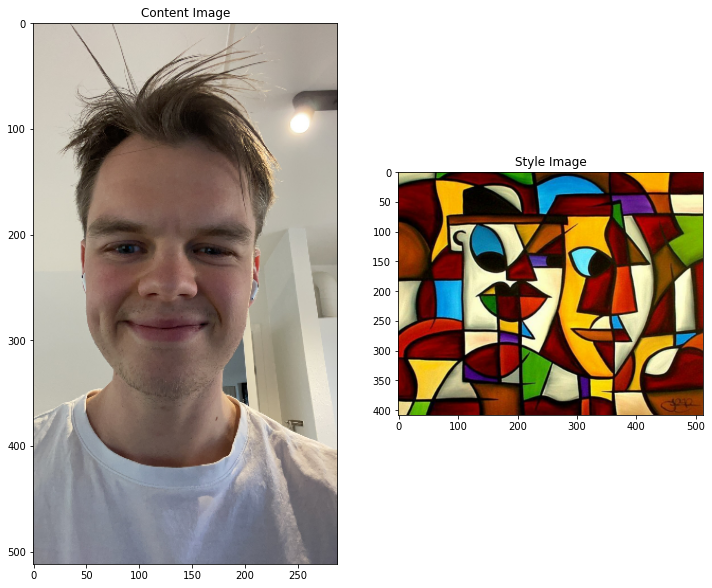

In [54]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [55]:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

In [56]:
hub_model

<tensorflow.python.saved_model.load.Loader._recreate_base_user_object.<locals>._UserObject at 0x183be88ec10>

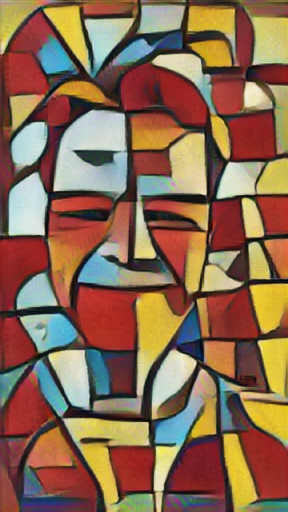

In [57]:
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
tensor_to_image(stylized_image)

In [58]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [59]:
def img_scaler(image, max_dim = 200):
  # Casts a tensor to a new type.
  original_shape = tf.cast(tf.shape(image)[:-1], tf.float32)
  # Creates a scale constant for the image
  scale_ratio = 4 * max_dim / max(original_shape)
  # Casts a tensor to a new type.
  new_shape = tf.cast(original_shape * scale_ratio, tf.int32)
  # Resizes the image based on the scaling constant generated above
  return tf.image.resize(image, new_shape)

In [60]:

def load_img(path_to_img):
  # Reads and outputs the entire contents of the input filename.
  img = tf.io.read_file(path_to_img)
  # Detect whether an image is a BMP, GIF, JPEG, or PNG, and 
  # performs the appropriate operation to convert the input 
  # bytes string into a Tensor of type dtype
  img = tf.image.decode_image(img, channels=3)
  # Convert image to dtype, scaling (MinMax Normalization) its values if needed.
  img = tf.image.convert_image_dtype(img, tf.float32)
  # Scale the image using the custom function we created
  img = img_scaler(img)
  # Adds a fourth dimension to the Tensor because
  # the model requires a 4-dimensional Tensor
  return img[tf.newaxis, :]

In [61]:
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

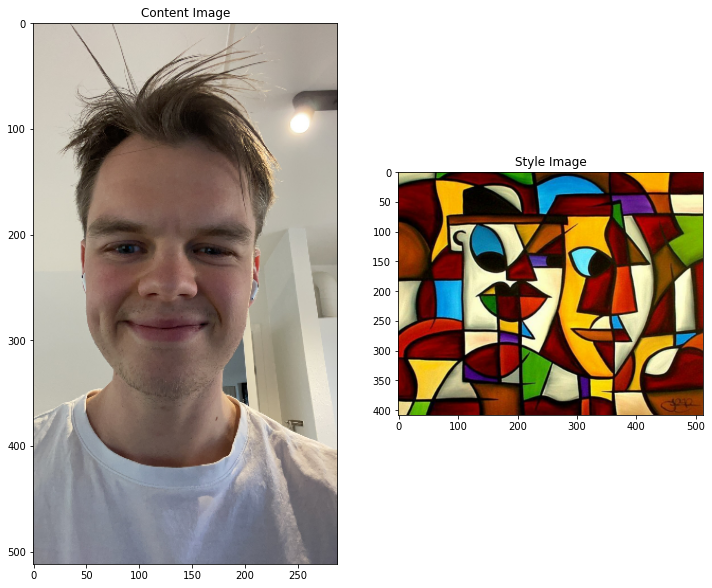

In [62]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [63]:

# Creates a pre-trained VGG model which takes an input and returns a list of intermediate output values 
def vgg_layers(layer_names):
  """ Creates a vgg model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False
  outputs = [vgg.get_layer(name).output for name in layer_names]
  model = tf.keras.Model([vgg.input], outputs)
  return model

In [64]:
def vgg_layers(layer_names):
  """ Creates a vgg model that returns a list of intermediate output values."""
  # Load our model. Load pretrained VGG, trained on imagenet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  model = tf.keras.Model([vgg.input], outputs)
  return model

In [65]:
# We will use block5 conv2 layer for content 
content_layers = ['block5_conv2'] 
# We will use conv1 layers from every block for style 
style_layers = ['block1_conv1','block2_conv1','block3_conv1', 'block4_conv1','block5_conv1']

In [66]:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [67]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

block1_conv1
  shape:  (1, 408, 512, 64)
  min:  0.0
  max:  817.67615
  mean:  33.69381

block2_conv1
  shape:  (1, 204, 256, 128)
  min:  0.0
  max:  5064.6323
  mean:  173.60413

block3_conv1
  shape:  (1, 102, 128, 256)
  min:  0.0
  max:  9474.6875
  mean:  215.60109

block4_conv1
  shape:  (1, 51, 64, 512)
  min:  0.0
  max:  19608.74
  mean:  748.9876

block5_conv1
  shape:  (1, 25, 32, 512)
  min:  0.0
  max:  3365.1367
  mean:  64.964455



In [68]:
def gram_matrix(input_tensor):
  # Tensor contraction over specified indices and outer product.
  # Matrix multiplication
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  # Save the shape of the input tensor
  input_shape = tf.shape(input_tensor)
  # Casts a tensor to a new type.
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  # Divide matrix multiplication output to num_locations
  return result/(num_locations)

In [69]:
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [70]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
      super(StyleContentModel, self).__init__()

    # The main 
    self.vgg =  vgg_layers(style_layers + content_layers)
    self.vgg.trainable = False

    # Used as keys in dict creation
    self.style_layers = style_layers
    self.content_layers = content_layers
    # self.num_style_layers = len(style_layers)
    

  def call(self, inputs):
    # Process the image input
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)

    # Feed the preprocessed image to the VGG19 model
    outputs = self.vgg(preprocessed_input)
    # Separate style and content outputs
    style_outputs, content_outputs = (outputs[:len(self.style_layers)], 
                                      outputs[len(self.style_layers):])
    # Process style output before dict creation
    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]


    # Create two dicts for content and style outputs
    content_dict = {content_name:value 
                    for content_name, value 
                    in zip(self.content_layers, content_outputs)}
    style_dict = {style_name:value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}
    
    return {'content':content_dict, 'style':style_dict}
  
extractor = StyleContentModel(style_layers, content_layers)
# Set your style and content target values:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

RuntimeError: It looks like you are subclassing `Model` and you forgot to call `super(YourClass, self).__init__()`. Always start with this line.

In [24]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = True

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

In [25]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.0132947
    max:  27738.639
    mean:  214.82584

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  40211.33
    mean:  7427.967

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  154852.11
    mean:  7953.1284

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  1528654.4
    mean:  125037.07

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  256902.0
    mean:  1485.3489

Contents:
   block5_conv2
    shape:  (1, 32, 18, 512)
    min:  0.0
    max:  1308.8386
    mean:  15.582058


In [26]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

In [27]:
image = tf.Variable(content_image)

In [28]:
# Create an optimizer. The paper recommends LBFGS, but Adam works okay, too:
opt = tf.optimizers.Adam(learning_rate=0.005, beta_1=0.99, epsilon=1e-1)

# To optimize this, use a weighted combination of the two losses to get the total loss:
style_weight=1e-2
content_weight=1e4

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / len(style_layers)

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / len(content_layers)
    loss = style_loss + content_loss
    return loss

In [29]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [30]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

In [31]:
style_weight=1e-2
content_weight=1e4

In [32]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

In [33]:
total_variation_weight=125

@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)
    loss += total_variation_weight*tf.image.total_variation(image)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))
  return loss, grad

In [34]:
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

  return loss, grad

In [35]:
import IPython.display as display
from tqdm import tqdm
image = tf.Variable(content_image)
train_loss_results = []

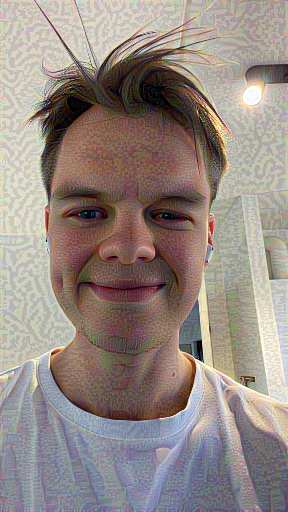

In [36]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

....................................................................................................

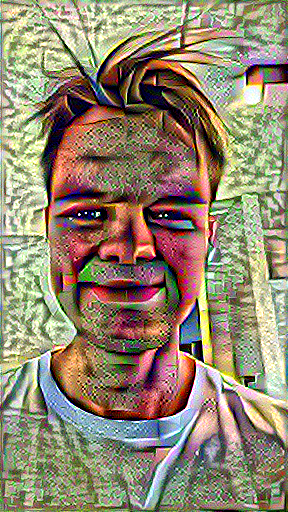

Train step: 100


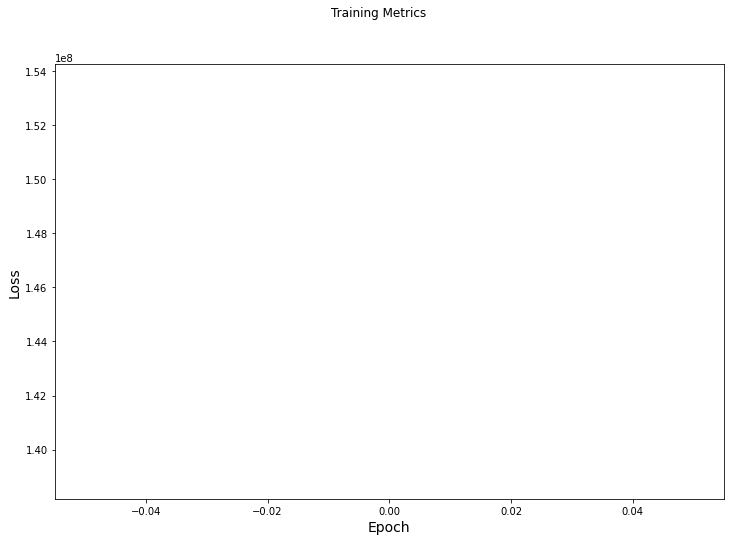

....................................................................................................

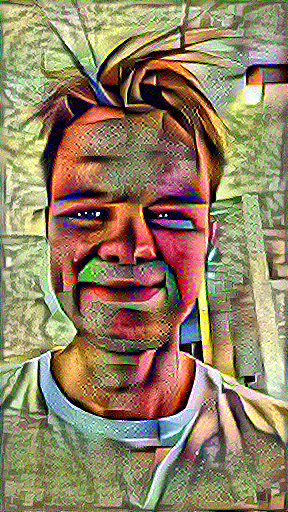

Train step: 200


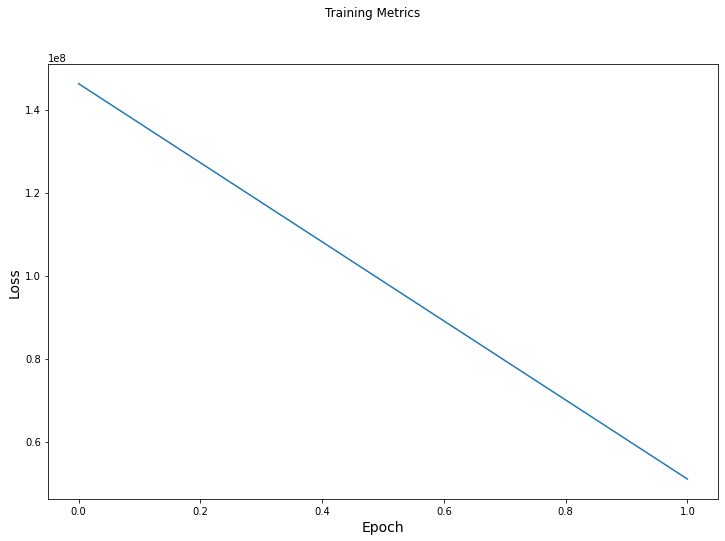

....................................................................................................

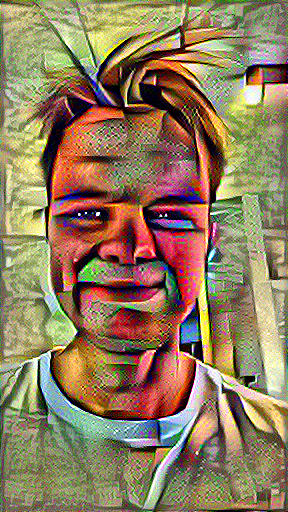

Train step: 300


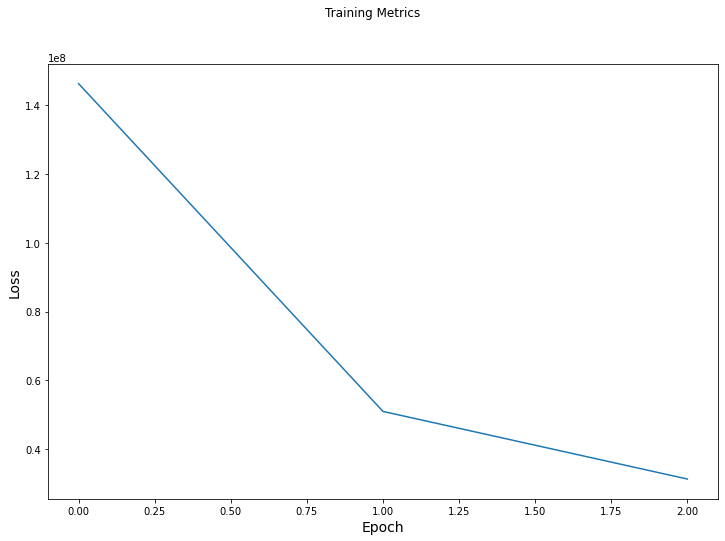

....................................................................................................

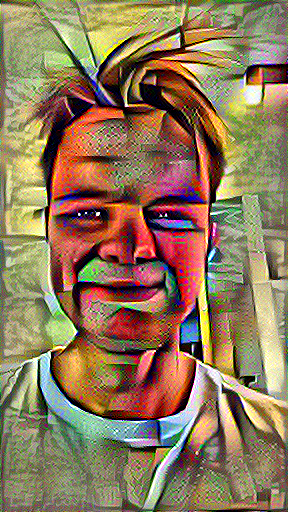

Train step: 400


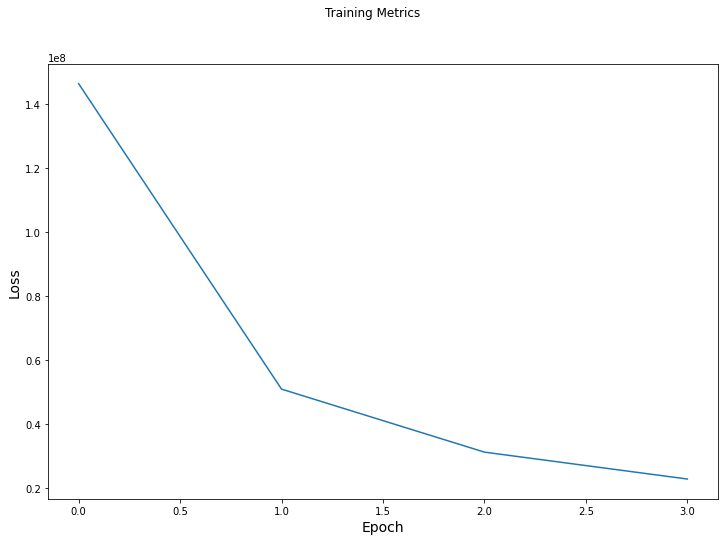

....................................................................................................

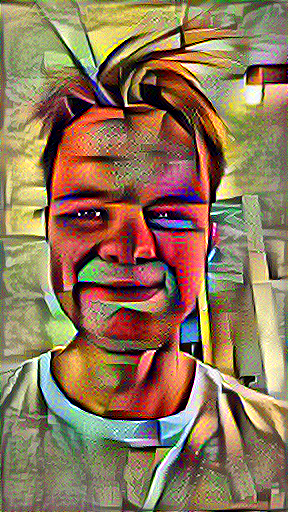

Train step: 500


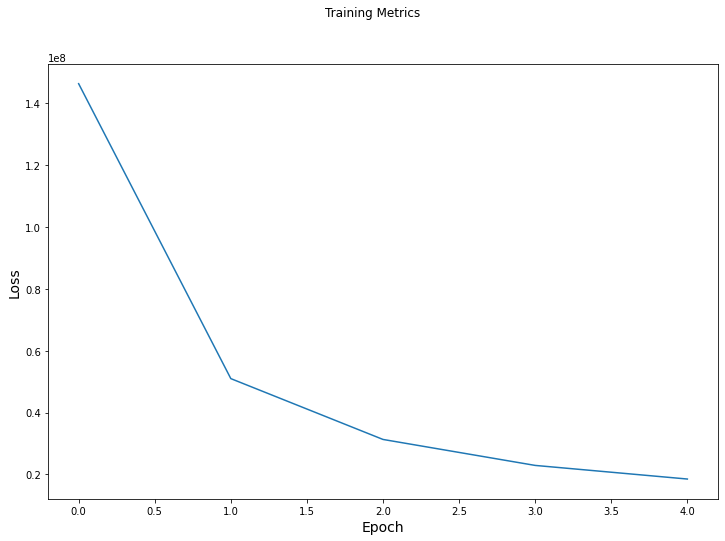

....................................................................................................

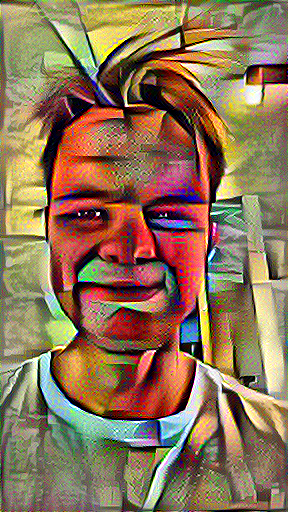

Train step: 600


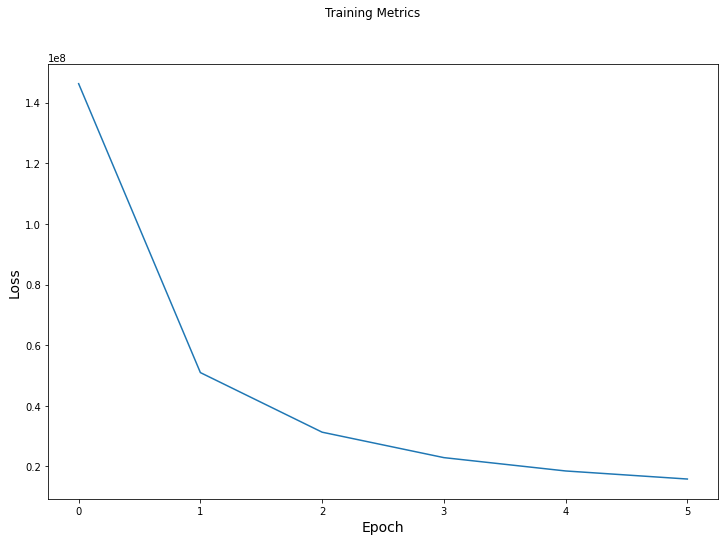

....................................................................................................

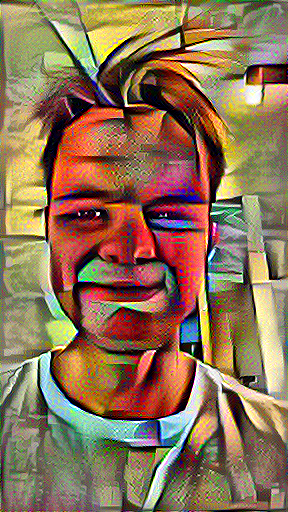

Train step: 700


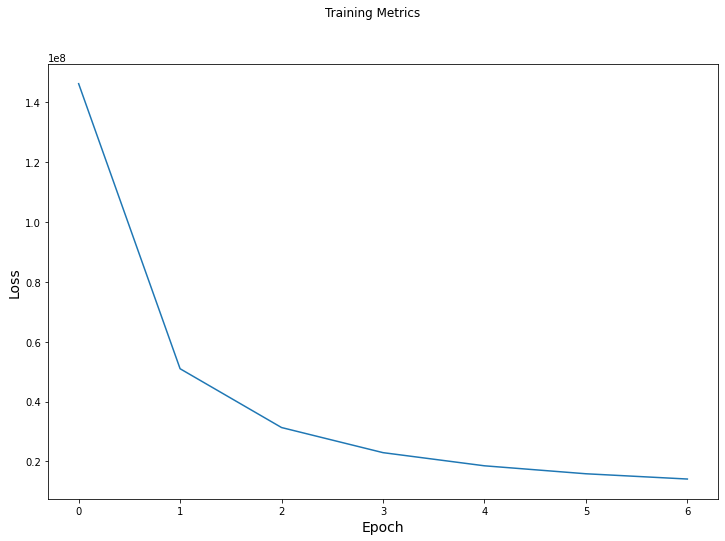

....................................................................................................

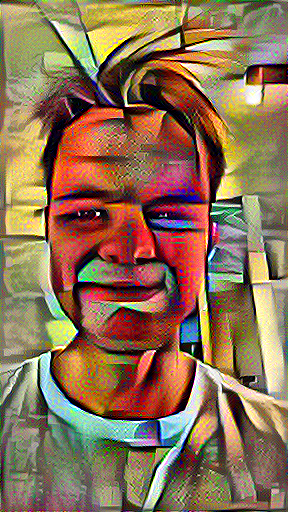

Train step: 800


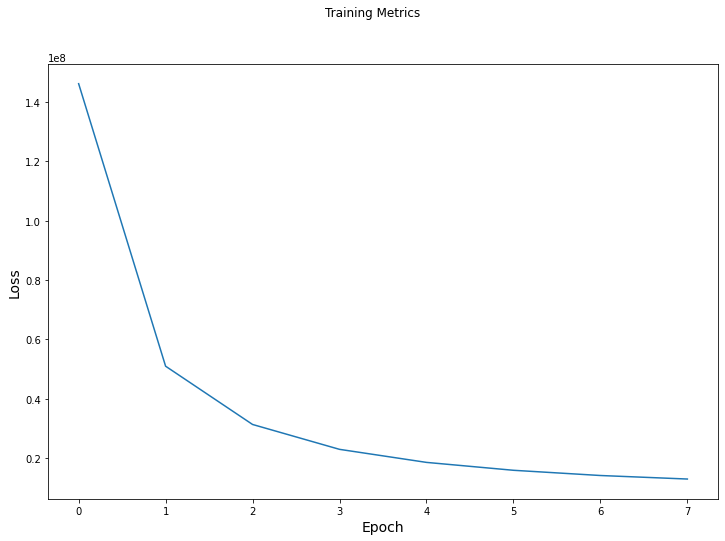

....................................................................................................

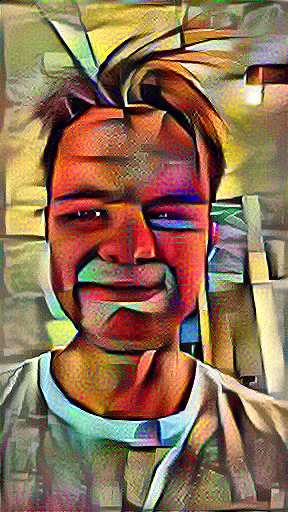

Train step: 900


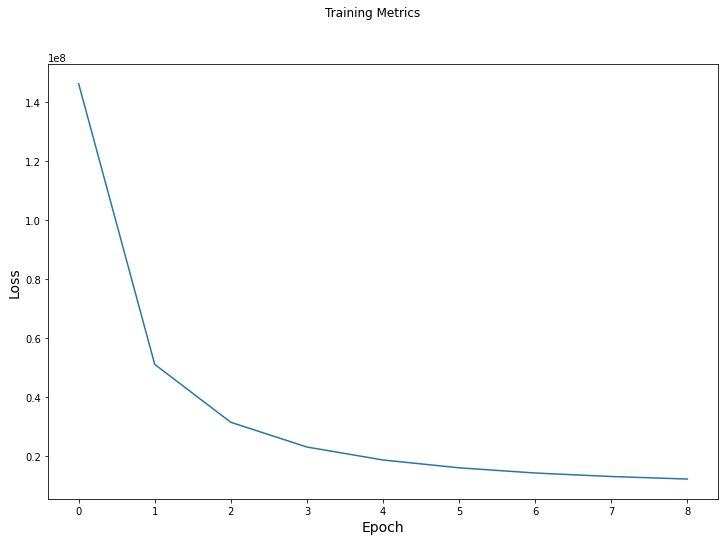

....................................................................................................

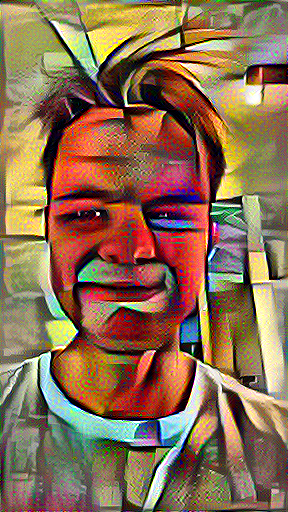

Train step: 1000


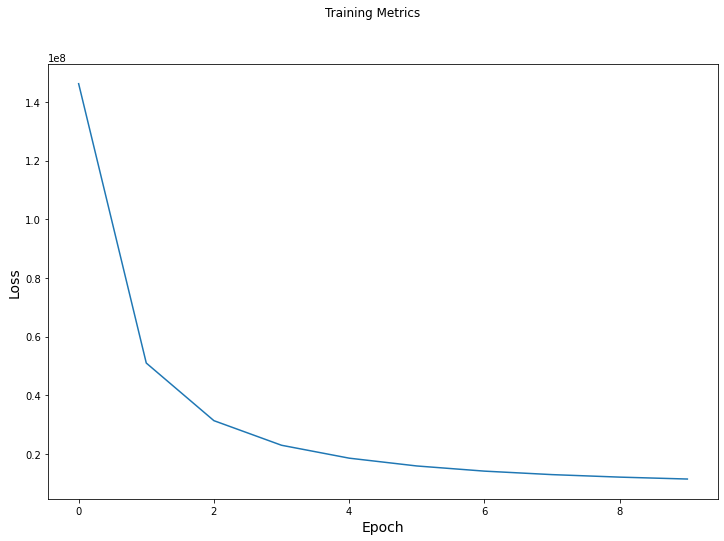

....................................................................................................

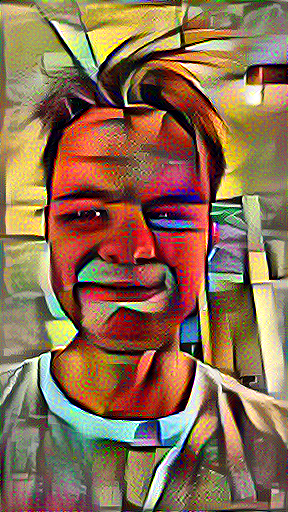

Train step: 1100


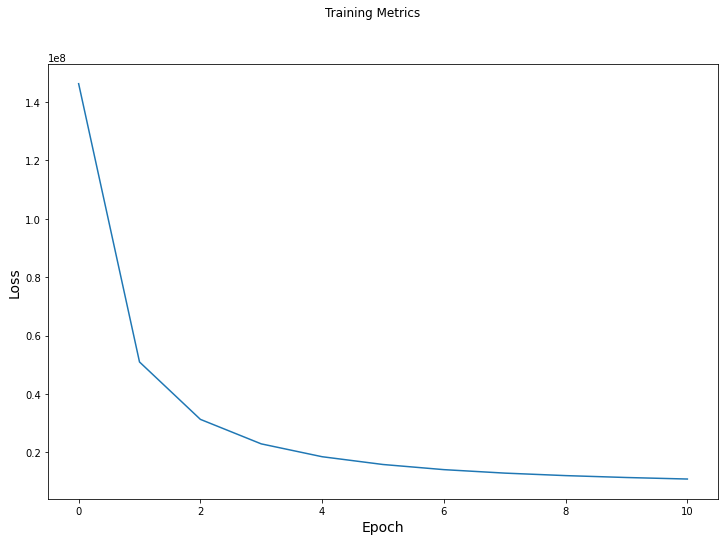

....................................................................................................

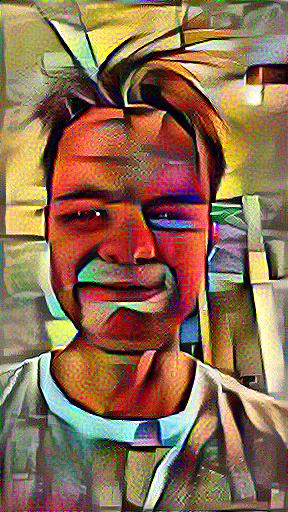

Train step: 1200


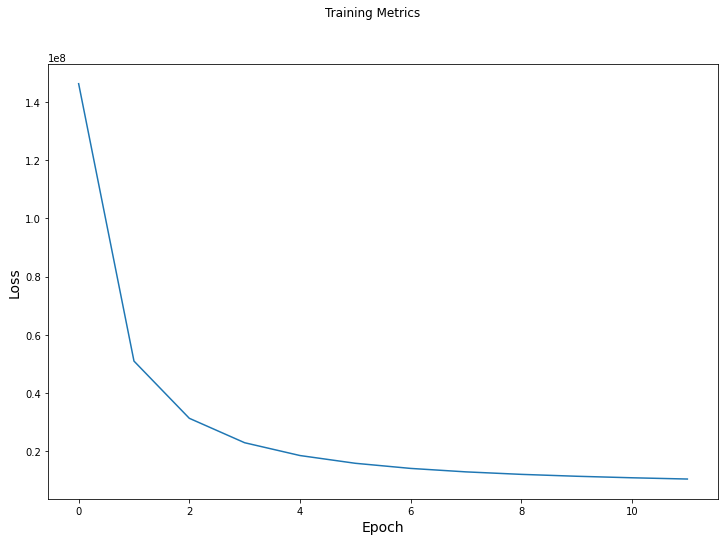

....................................................................................................

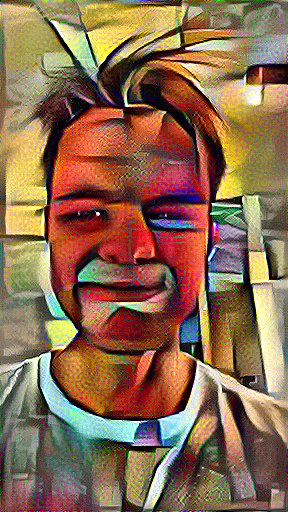

Train step: 1300


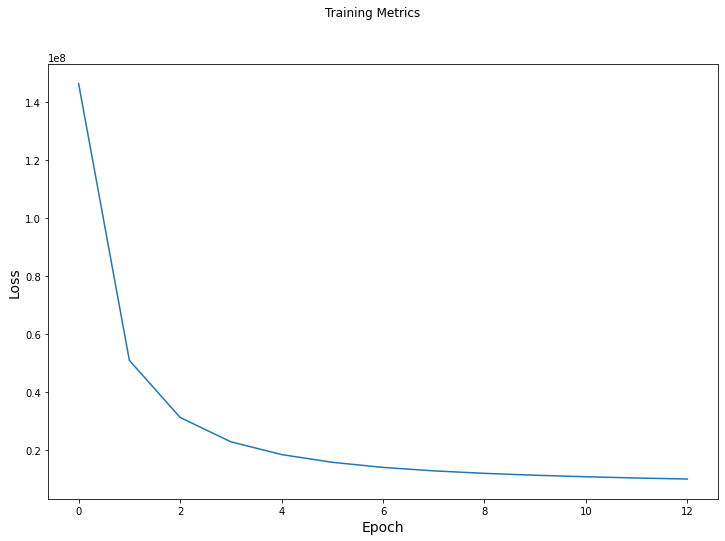

....................................................................................................

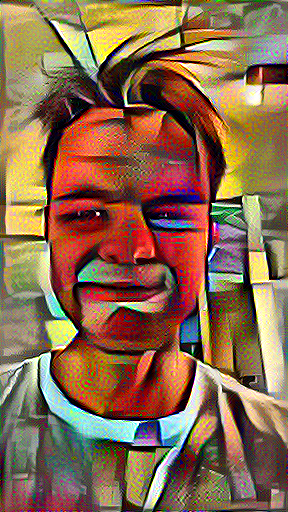

Train step: 1400


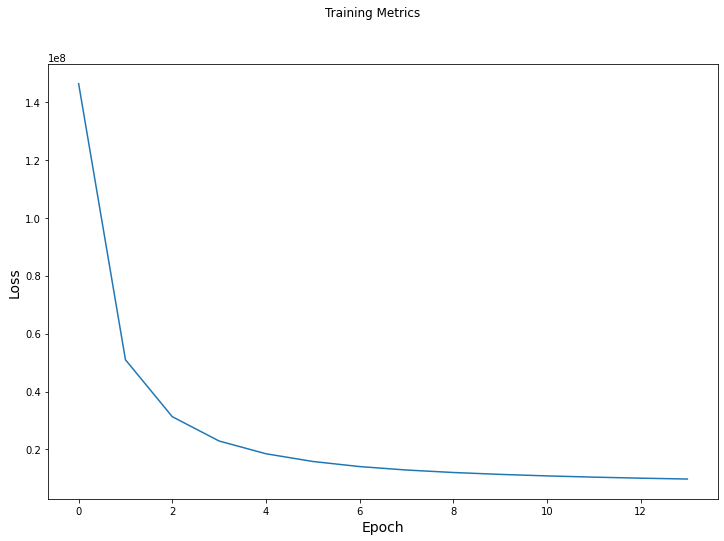

....................................................................................................

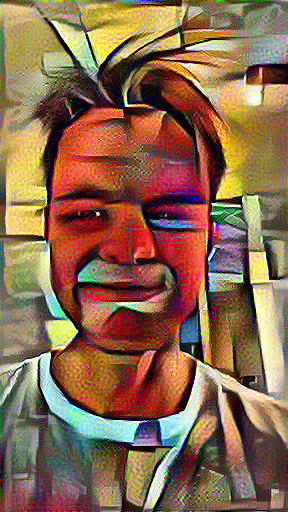

Train step: 1500


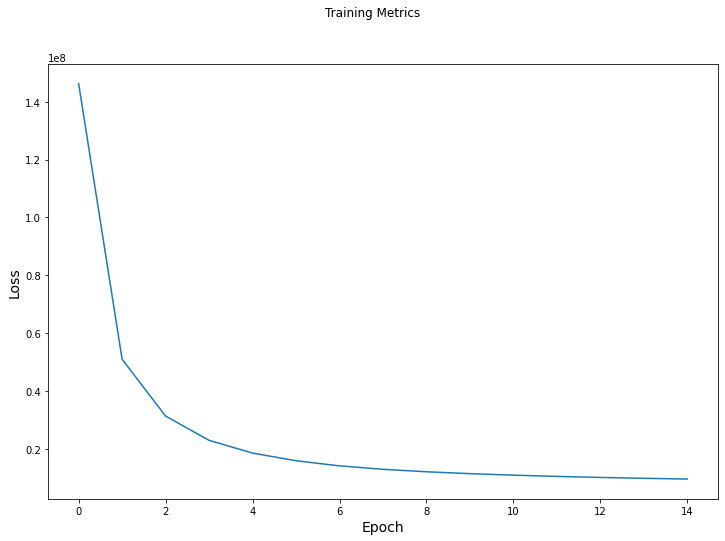

....................................................................................................

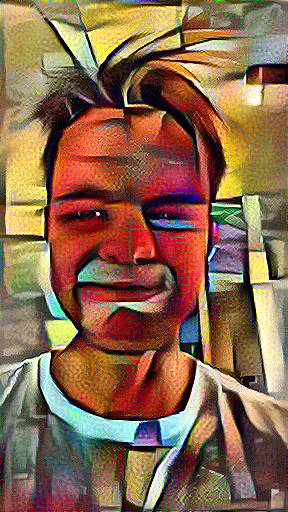

Train step: 1600


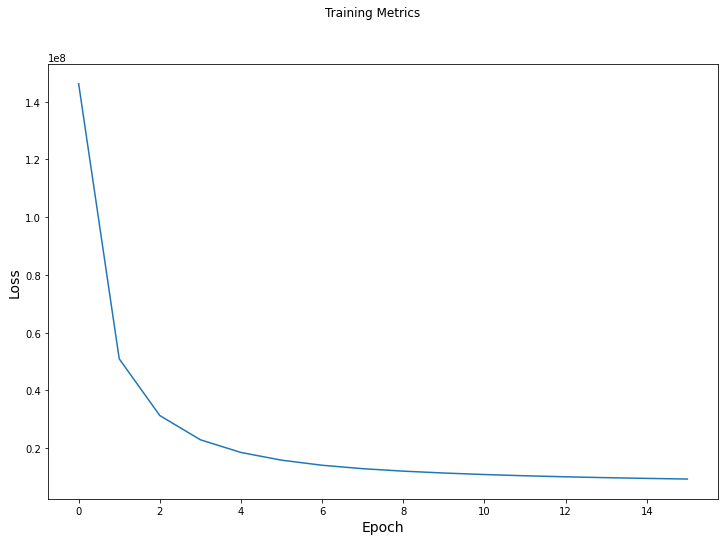

....................................................................................................

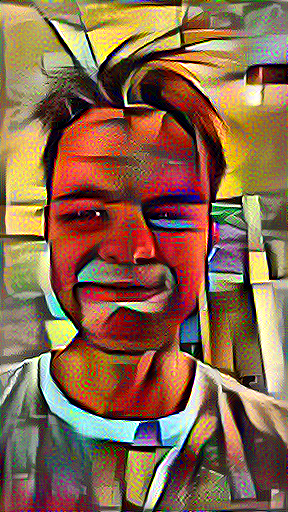

Train step: 1700


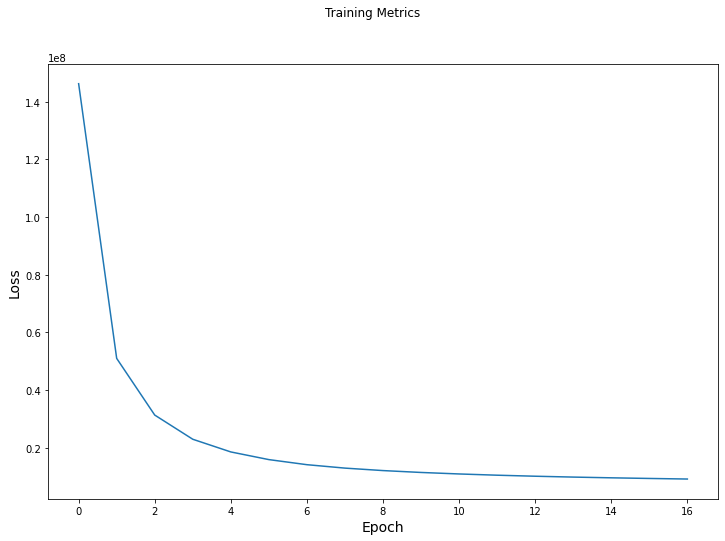

....................................................................................................

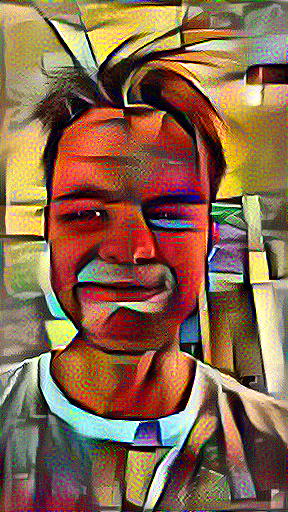

Train step: 1800


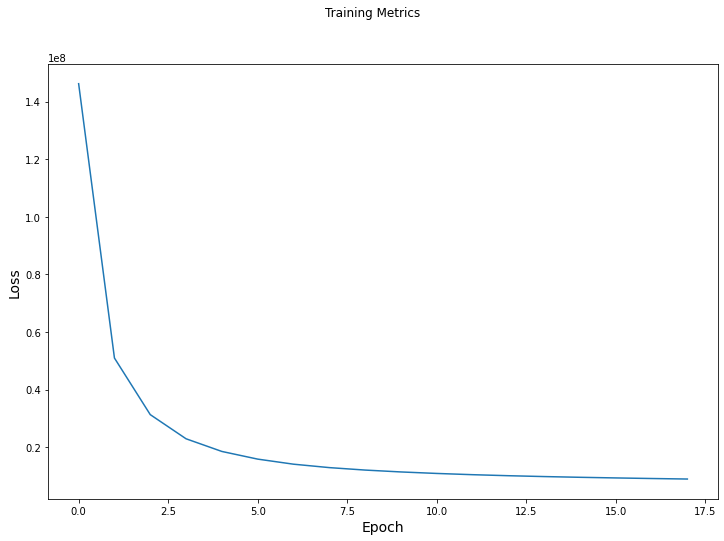

....................................................................................................

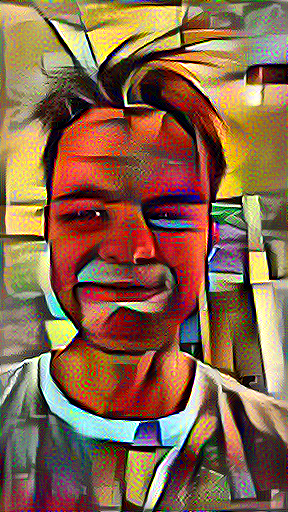

Train step: 1900


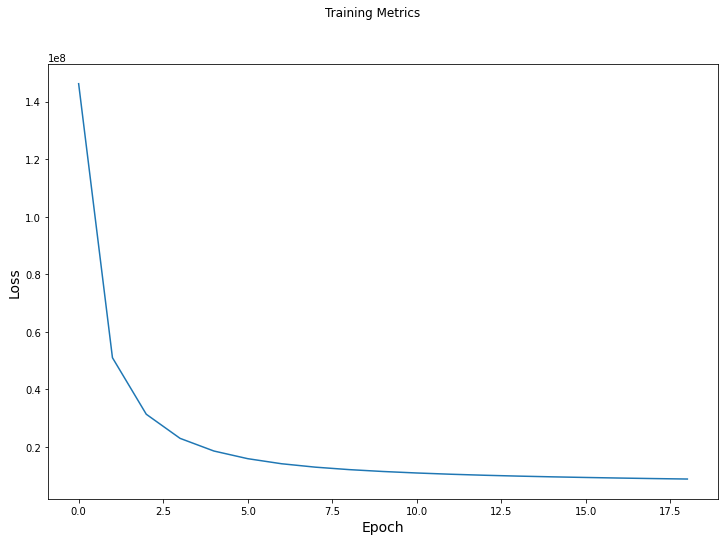

....................................................................................................

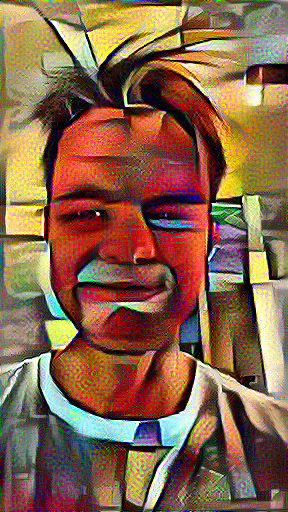

Train step: 2000


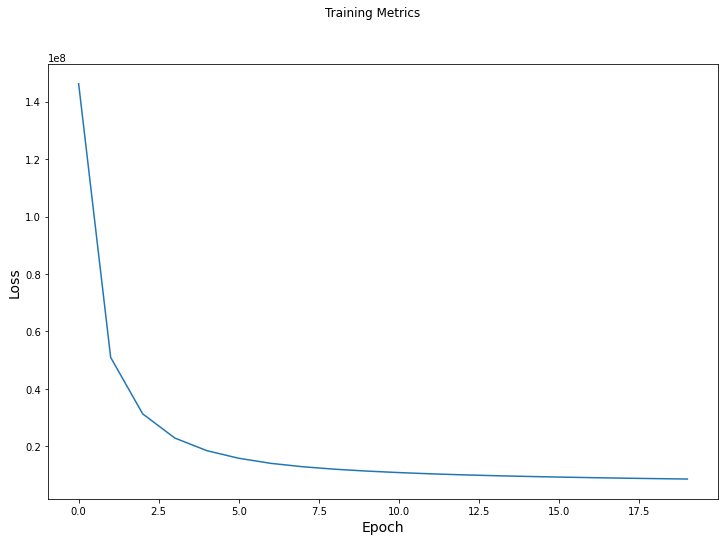

....................................................................................................

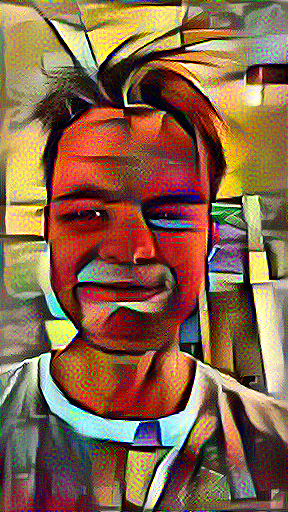

Train step: 2100


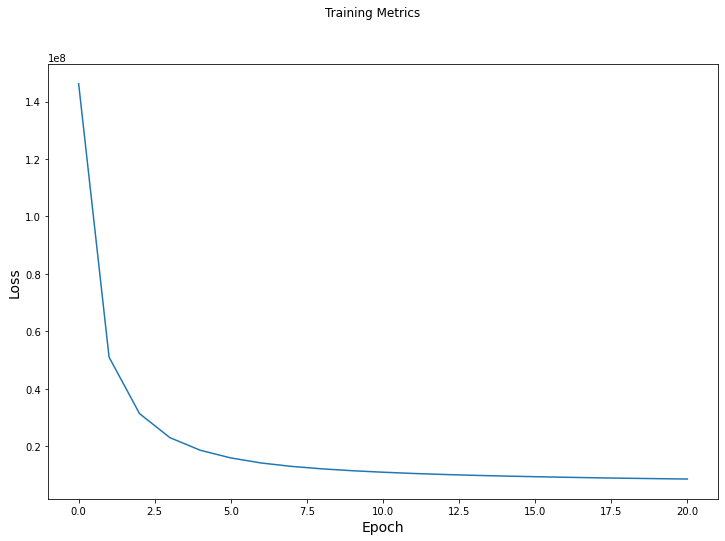

....................................................................................................

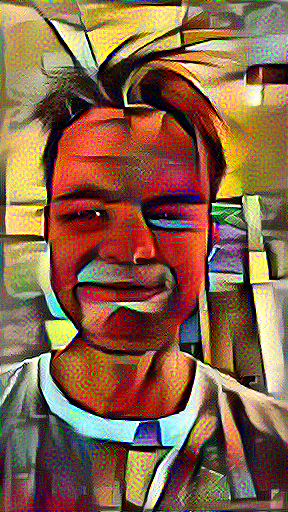

Train step: 2200


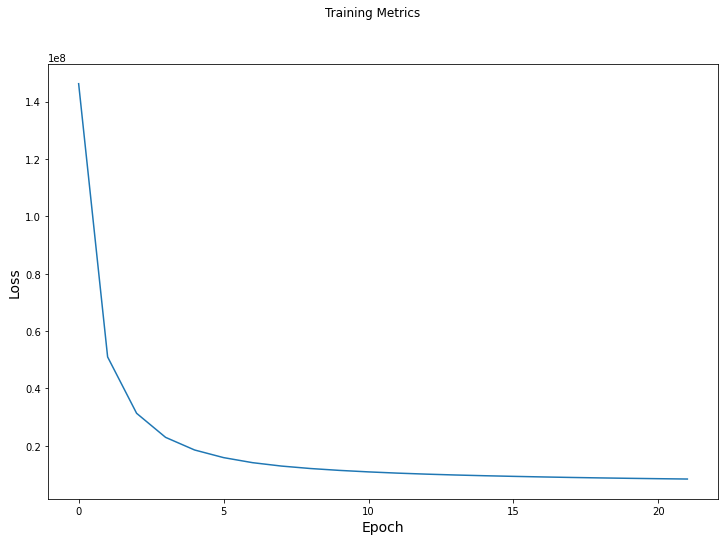

....................................................................................................

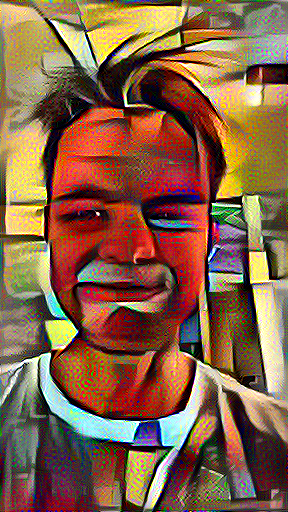

Train step: 2300


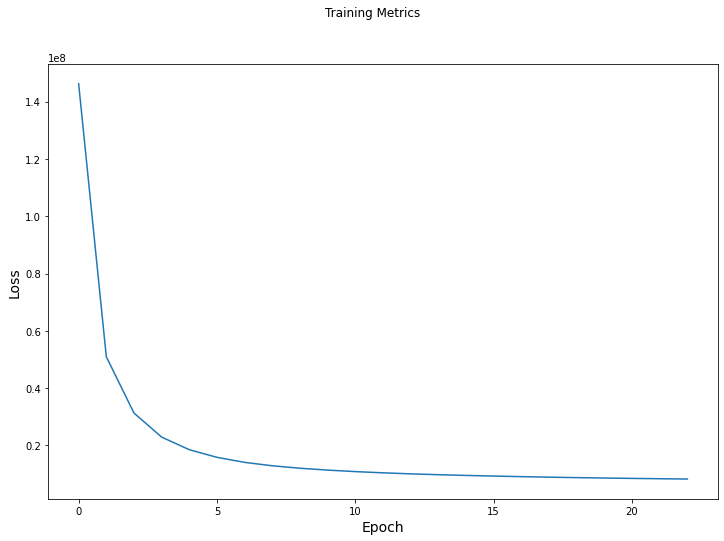

....................................................................................................

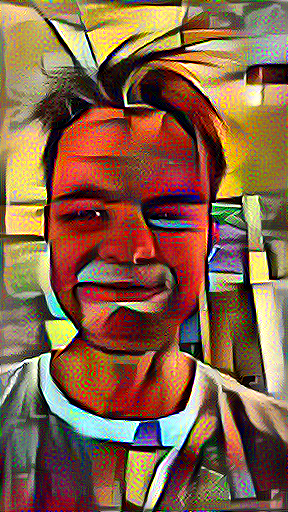

Train step: 2400


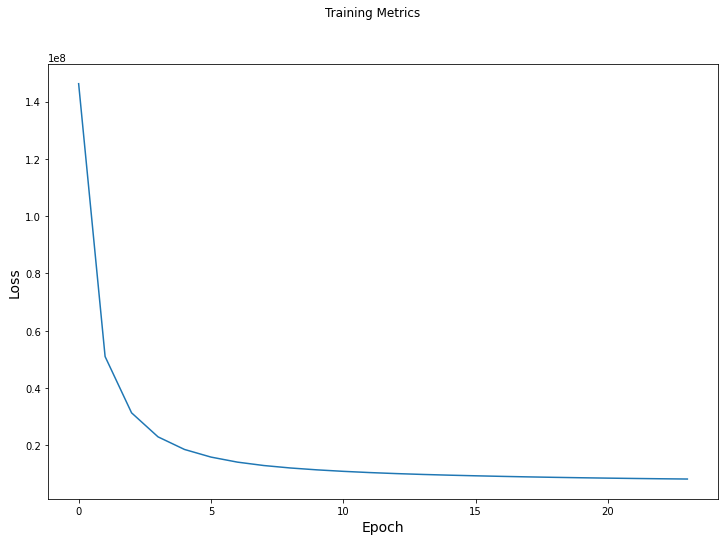

....................................................................................................

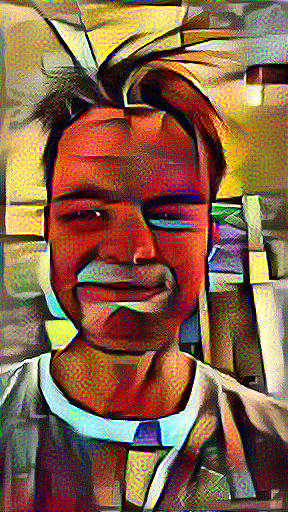

Train step: 2500


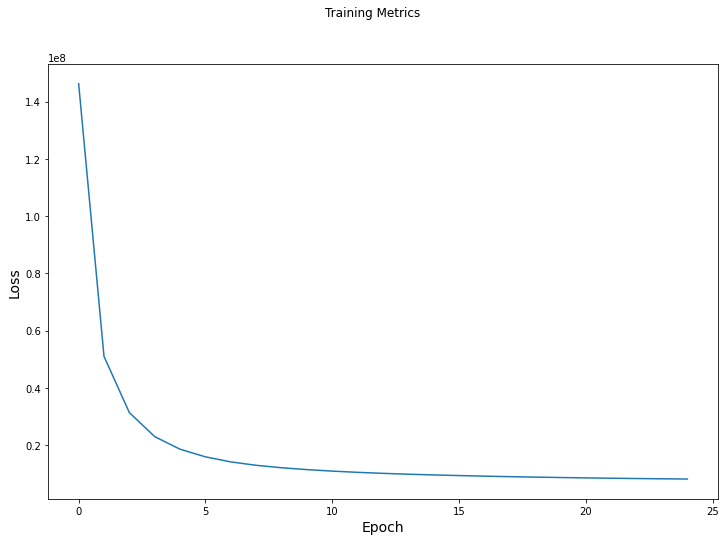

Total time: 2905.6


In [37]:
import time
start = time.time()

train_loss_results = []

epochs = 25
steps_per_epoch = 100

step = 0
for n in range(epochs):
    epoch_loss_avg = tf.keras.metrics.Mean()
    for m in range(steps_per_epoch):
        step += 1
        loss, grad = train_step(image)
        # Track progress
        epoch_loss_avg.update_state(loss)  
        print(".", end='')
    train_loss_results.append(epoch_loss_avg.result())
    display.display(tensor_to_image(image))
    print("Train step: {}".format(step))

    fig, axes = plt.subplots(1, sharex=True, figsize=(12, 8))
    fig.suptitle('Training Metrics')

    axes.set_ylabel("Loss", fontsize=14)
    axes.plot(train_loss_results)

    axes.set_xlabel("Epoch", fontsize=14)
    plt.show()

end = time.time()
print("Total time: {:.1f}".format(end-start))

import IPython.display as display
from tqdm import tqdm
image = tf.Variable(content_image)
train_loss_results = []
epochs = 20
steps_per_epoch = 100
step = 0
for n in tqdm(range(epochs)):
  epoch_loss_avg = tf.keras.metrics.Mean()
  for m in tqdm(range(steps_per_epoch)):
    step += 1
    loss, grad = train_step(image)
    # Track progress
    epoch_loss_avg.update_state(loss)  
    print(".", end='')
  train_loss_results.append(epoch_loss_avg.result())
  print(f"\nEpoch: {n} Loss: {epoch_loss_avg.result()}")
  plt.imshow(image[0])
  plt.show()
  print("Train step: {}".format(step))

In [38]:
tf.keras.preprocessing.image.save_img('stylized-image.png', image[0])

In [39]:
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

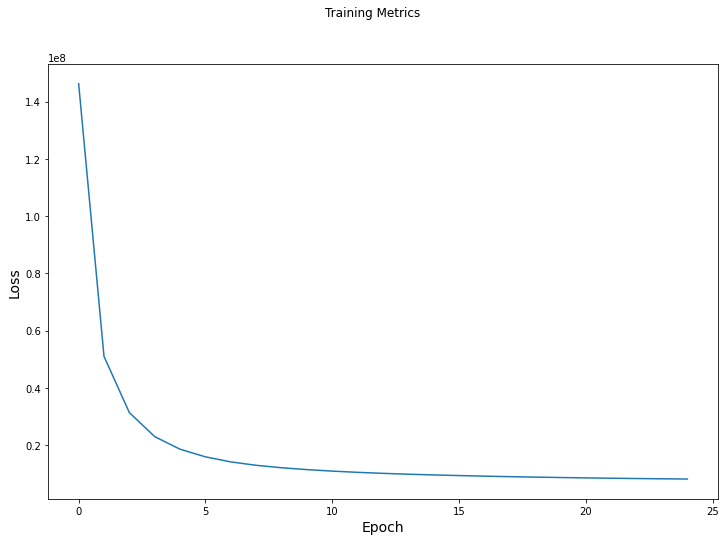

In [40]:
fig, axes = plt.subplots(1, sharex=True, figsize=(12, 8))
fig.suptitle('Training Metrics')

axes.set_ylabel("Loss", fontsize=14)
axes.plot(train_loss_results)

axes.set_xlabel("Epoch", fontsize=14)
plt.show()

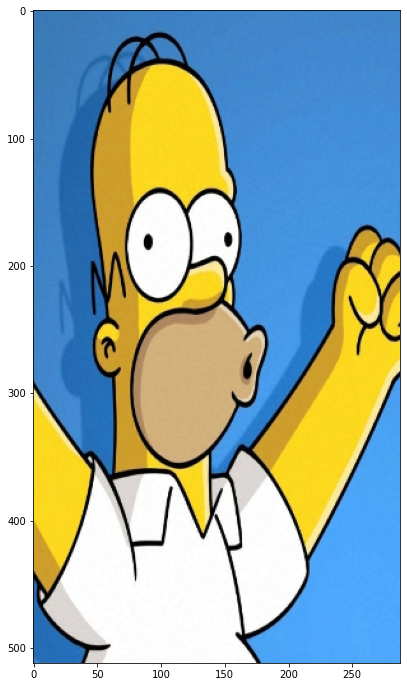

In [41]:
homer = str(Path("C:/Users/z6hjb/Downloads/homer.png"))
content_image2 = load_img(homer)
content_image2 = tf.image.resize(content_image2, (512, 288))
content_image2 = tf.Variable(content_image2)
outputs = extractor(content_image2)
opt.apply_gradients([(grad, content_image2)])
content_image2.assign(tf.clip_by_value(content_image2, 
                            clip_value_min=0.0, 
                            clip_value_max=1.0))
plt.imshow(content_image2[0])
plt.show()

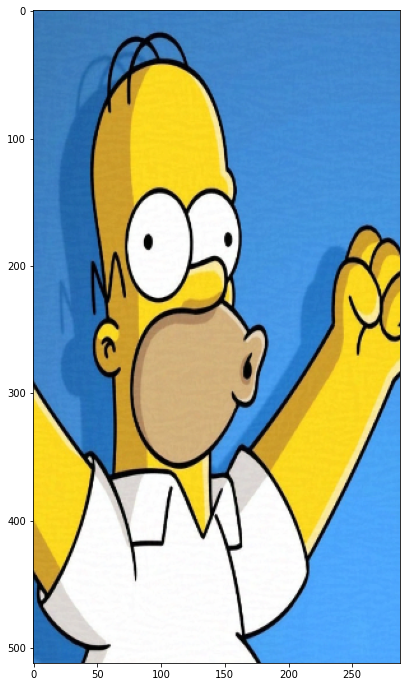

In [42]:
train_step(content_image2)
plt.imshow(content_image2[0])
plt.show()

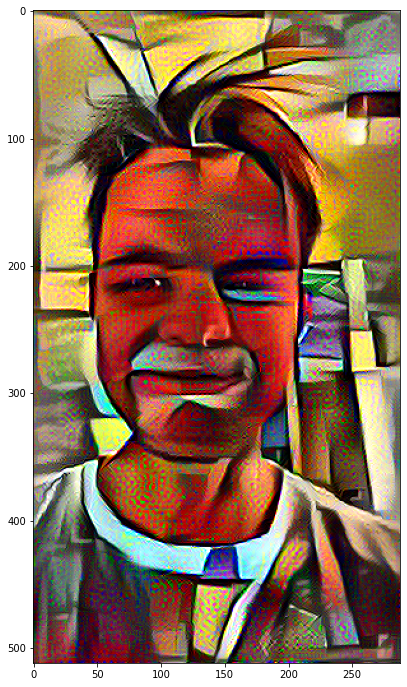

In [43]:
train_step(image)
plt.imshow(image[0])
plt.show()

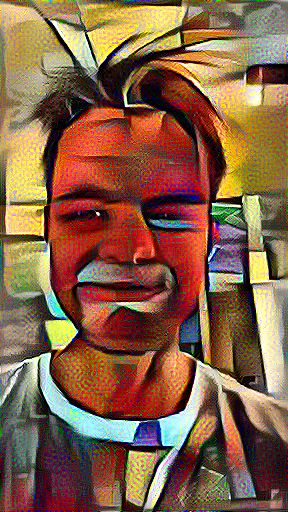

In [44]:
train_step(image)
tensor_to_image(image)

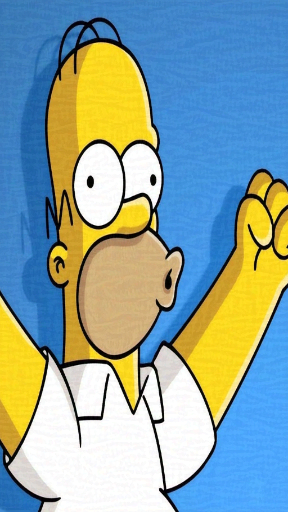

In [45]:
train_step(content_image2)
tensor_to_image(content_image2)

In [46]:
image

<tf.Variable 'Variable:0' shape=(1, 512, 288, 3) dtype=float32, numpy=
array([[[[0.37160078, 0.28940406, 0.2715032 ],
         [0.5016561 , 0.48127726, 0.33014268],
         [0.40205455, 0.422771  , 0.16035914],
         ...,
         [0.7165301 , 0.67309564, 0.71490127],
         [0.6304714 , 0.69122195, 0.7130754 ],
         [0.81449926, 0.7236909 , 0.72182965]],

        [[0.62491167, 0.5958453 , 0.39754862],
         [0.47178227, 0.49460742, 0.30869892],
         [0.4865243 , 0.52905095, 0.3177459 ],
         ...,
         [0.57316947, 0.60693574, 0.5107669 ],
         [0.56065226, 0.5879429 , 0.50541234],
         [0.4676404 , 0.6354138 , 0.6423895 ]],

        [[0.6400435 , 0.662432  , 0.5124387 ],
         [0.55290765, 0.5531658 , 0.45458248],
         [0.5578868 , 0.58690983, 0.5174185 ],
         ...,
         [0.5237914 , 0.3190104 , 0.5609546 ],
         [0.52539545, 0.5392937 , 0.49782392],
         [0.41874456, 0.4398392 , 0.39175504]],

        ...,

        [[0.28845114,

In [47]:
content_image

<tf.Tensor: shape=(1, 512, 288, 3), dtype=float32, numpy=
array([[[[0.7938113 , 0.7585172 , 0.72322303],
         [0.7963236 , 0.7610295 , 0.7257353 ],
         [0.79822314, 0.76292896, 0.7276348 ],
         ...,
         [0.65833336, 0.62303925, 0.58774513],
         [0.6566789 , 0.6213848 , 0.5860907 ],
         [0.65790445, 0.62261033, 0.5873162 ]],

        [[0.79822314, 0.762929  , 0.72763485],
         [0.78008586, 0.7447917 , 0.7094976 ],
         [0.7965687 , 0.7612746 , 0.7259804 ],
         ...,
         [0.6628064 , 0.6275123 , 0.59221816],
         [0.6627451 , 0.627451  , 0.5921569 ],
         [0.6627451 , 0.627451  , 0.5921569 ]],

        [[0.7933824 , 0.7580883 , 0.7227941 ],
         [0.7985295 , 0.7632354 , 0.7279412 ],
         [0.7968138 , 0.7615197 , 0.7262255 ],
         ...,
         [0.6691177 , 0.6338236 , 0.59852946],
         [0.6695466 , 0.6342525 , 0.5989584 ],
         [0.66470593, 0.6294118 , 0.5941177 ]],

        ...,

        [[0.50735295, 0.50735295, 